<a href="https://colab.research.google.com/github/ajigps/hello-world/blob/master/FORECAST2_MMA_Biofarma.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import matplotlib
matplotlib.__version__

'3.7.0'

In [1]:
!pip install -U matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.2/9.2 MB 56.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 300.0/300.0 KB 25.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 965.4/965.4 KB 54.3 MB/s eta 0:00:00
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2


In [2]:
import pandas as pd


dataset = pd.read_csv('/content/drive/MyDrive/0. Paper/0. Kinetik/2023/biofarma_electricity.csv')

In [3]:
dataset

,Date,Energy,Power
0,2020/01/01,1025.90,0.00
1,2020/01/02,1028.16,2.26
2,2020/01/03,1050.98,22.82
3,2020/01/04,1070.75,19.77
4,2020/01/05,1072.79,2.04
...,...,...,...
239,2020/08/27,4792.68,20.30
240,2020/08/28,4816.14,23.46
241,2020/08/29,4837.06,20.92
242,2020/08/30,4847.69,10.63


In [4]:
print(dataset.columns)

Index(['Date', 'Energy', 'Power'], dtype='object')


In [5]:
import pandas as pd

# multi = 10

df = dataset.loc[:,['Date', 'Power']]

# traind = traind.sample(n=70*multi, random_state=42)#, replace=True

print(df)

# testd = pd.DataFrame.from_dict(dataset["test"])

# testd = testd.sample(n=30*multi, random_state=42)#, replace=True

# print(testd)

           Date  Power
0    2020/01/01   0.00
1    2020/01/02   2.26
2    2020/01/03  22.82
3    2020/01/04  19.77
4    2020/01/05   2.04
..          ...    ...
239  2020/08/27  20.30
240  2020/08/28  23.46
241  2020/08/29  20.92
242  2020/08/30  10.63
243  2020/08/31   7.46

[244 rows x 2 columns]


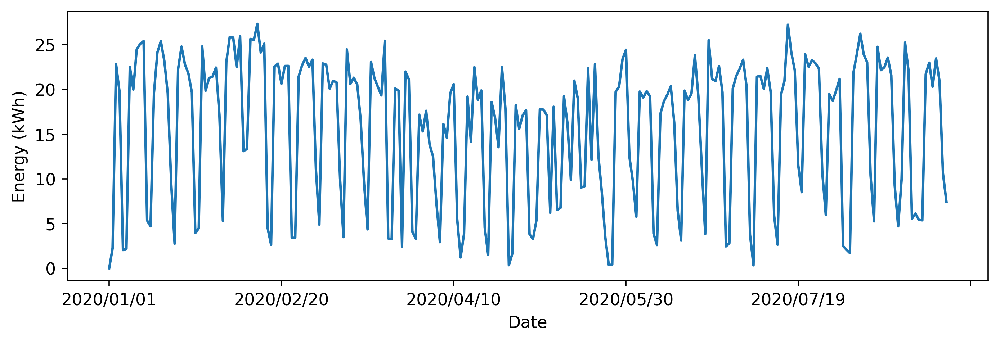

In [6]:
import matplotlib.pyplot as plt

plt.rcParams["figure.dpi"] = 330

plt.rcParams["figure.figsize"] = (10,3)

df.plot(x = 'Date', y = 'Power', legend=False)

plt.ylabel("Energy (kWh)")

plt.show()

# df.plot(x = '__index_level_0__', y = 'Temperature')

# plt.show()

In [7]:
from statsmodels.tsa.stattools import adfuller
result= adfuller(df["Power"])

In [8]:
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[4].items():
 print('\t%s: %.3f' % (key, value))

ADF Statistic: -2.248116
p-value: 0.189248
	1%: -3.459
	5%: -2.874
	10%: -2.574


In [9]:
df1 = pd.DataFrame(df.loc[:,["Power"]].diff())

df1["Date"] = df["Date"]

df1 = df1.dropna()

print(type(df1))

df1

<class 'pandas.core.frame.DataFrame'>


,Power,Date
1,2.26,2020/01/02
2,20.56,2020/01/03
3,-3.05,2020/01/04
4,-17.73,2020/01/05
5,0.14,2020/01/06
...,...,...
239,-2.69,2020/08/27
240,3.16,2020/08/28
241,-2.54,2020/08/29
242,-10.29,2020/08/30


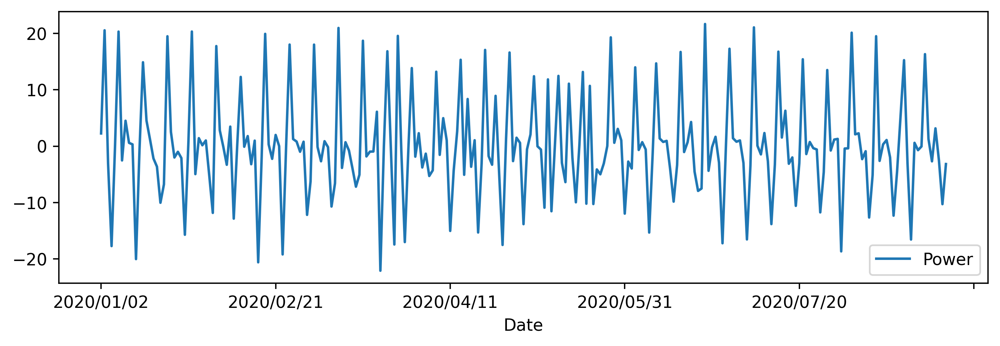

In [10]:
import matplotlib.pyplot as plt

plt.rcParams["figure.dpi"] = 330

df1.plot(x = 'Date', y = 'Power')

plt.show()

# df.plot(x = '__index_level_0__', y = 'Temperature')

# plt.show()

In [11]:
from statsmodels.tsa.stattools import adfuller
result= adfuller(df1["Power"])

print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[4].items():
 print('\t%s: %.3f' % (key, value))

ADF Statistic: -8.234650
p-value: 0.000000
	1%: -3.459
	5%: -2.874
	10%: -2.574


In [12]:
!pip install scalecast

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 709.9/709.9 KB 10.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.2/216.2 KB 18.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.1/133.1 KB 13.3 MB/s eta 0:00:00
  Created wheel for scalecast: filename=SCALECAST-0.17.4-py3-none-any.whl size=111598 sha256=b991c0c728c7056f1b0647c5c1fbf8af94ebad965f1b92263ad0b9823c003ade
  Stored in directory: /root/.cache/pip/wheels/f3/cd/f3/769d4f4725578355f995fb75b7ebc28f1cce577412d7b6e983
  Created wheel for eli5: filename=eli5-0.13.0-py2.py3-none-any.whl size=107748 sha256=1bcaabaacd598507f886223d961650984baf5b9c2f4f1fbd277011695716eed4
  Stored in directory: /root/.cache/pip/wheels/85/ac/25/ffcd87ef8f9b1eec324fdf339359be71f22612459d8c75d89c
Successfully built scalecast eli5
  Attempting unins

In [13]:
import pandas as pd
import numpy as np
import pickle
import seaborn as sns
import matplotlib.pyplot as plt
from scalecast.Forecaster import Forecaster
sns.set(rc={'figure.figsize':(15,8)})
# df = pd.read_csv('AirPassengers.csv',parse_dates=['Month'])

In [14]:
f1 = Forecaster(y=df1['Power'],
                   current_dates=df['Date'])
f1

Forecaster(
    DateStartActuals=2020-01-02T00:00:00.000000000
    DateEndActuals=2020-08-31T00:00:00.000000000
    Freq=D
    N_actuals=243
    ForecastLength=0
    Xvars=[]
    Differenced=0
    TestLength=0
    ValidationLength=1
    ValidationMetric=rmse
    ForecastsEvaluated=[]
    CILevel=None
    CurrentEstimator=None
    GridsFile=Grids
)

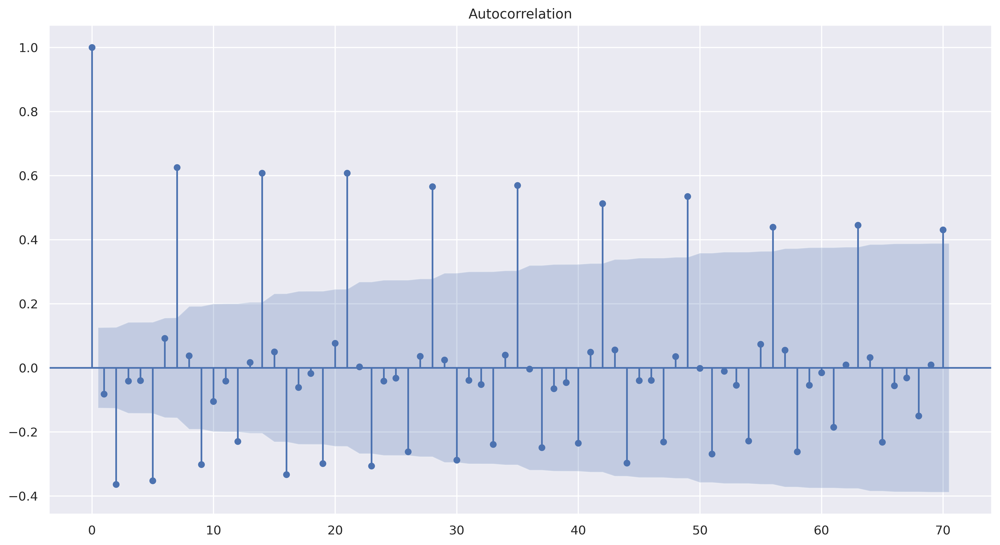

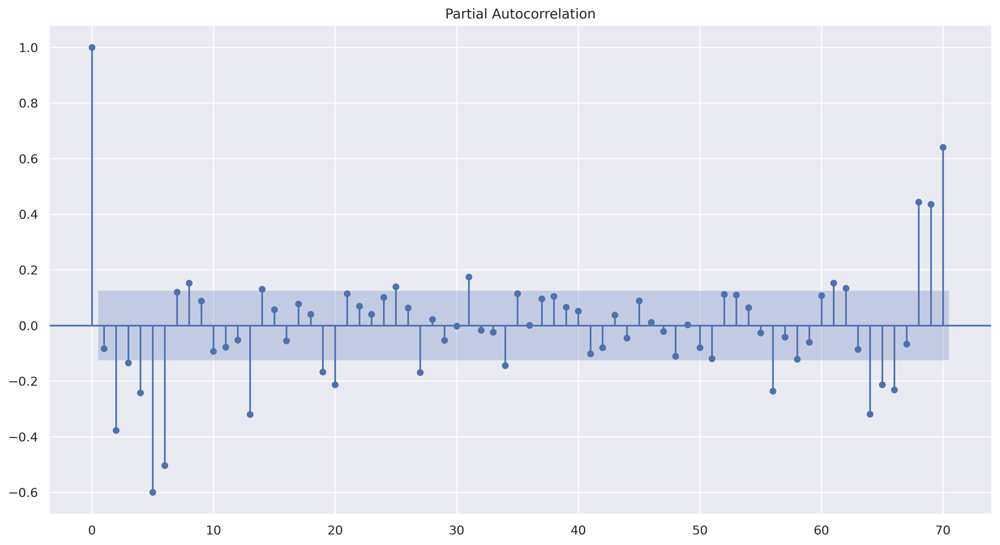

In [15]:
f1.plot_acf(lags=70)
plt.show()

f1.plot_pacf(lags=70)
plt.show()

In [16]:
f = Forecaster(y=df['Power'],
                   current_dates=df['Date'])
f

Forecaster(
    DateStartActuals=2020-01-01T00:00:00.000000000
    DateEndActuals=2020-08-31T00:00:00.000000000
    Freq=D
    N_actuals=244
    ForecastLength=0
    Xvars=[]
    Differenced=0
    TestLength=0
    ValidationLength=1
    ValidationMetric=rmse
    ForecastsEvaluated=[]
    CILevel=None
    CurrentEstimator=None
    GridsFile=Grids
)

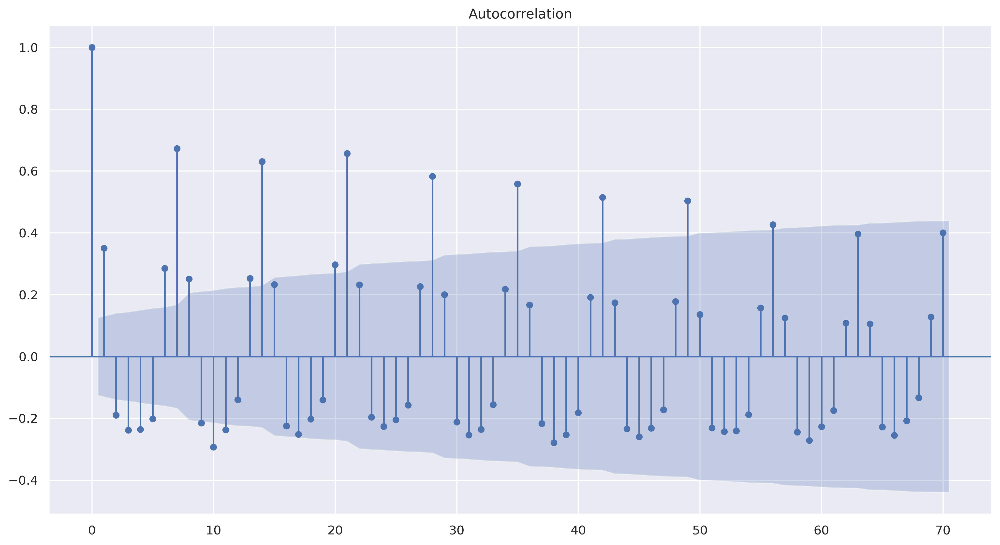

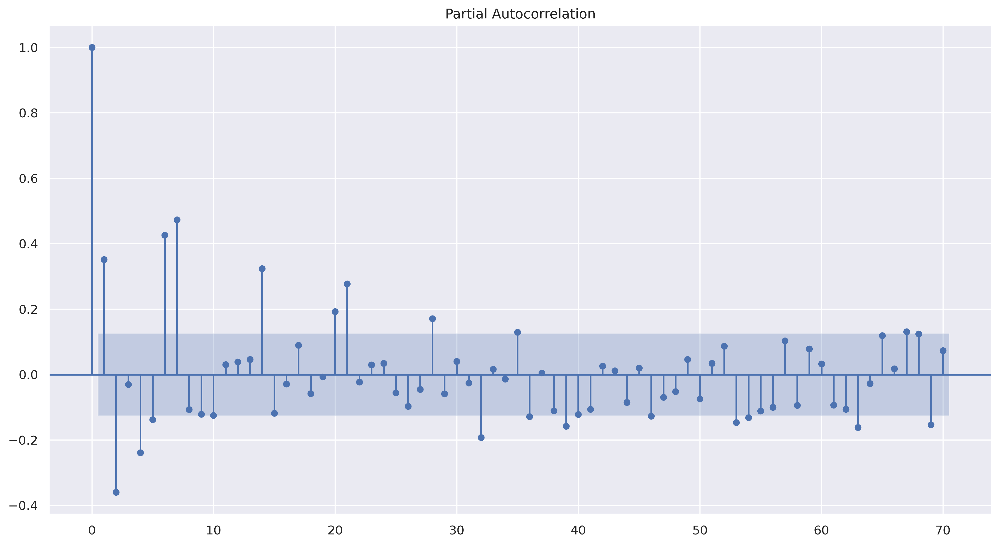

In [17]:
f.plot_acf(lags=70)
plt.show()

f.plot_pacf(lags=70)
plt.show()

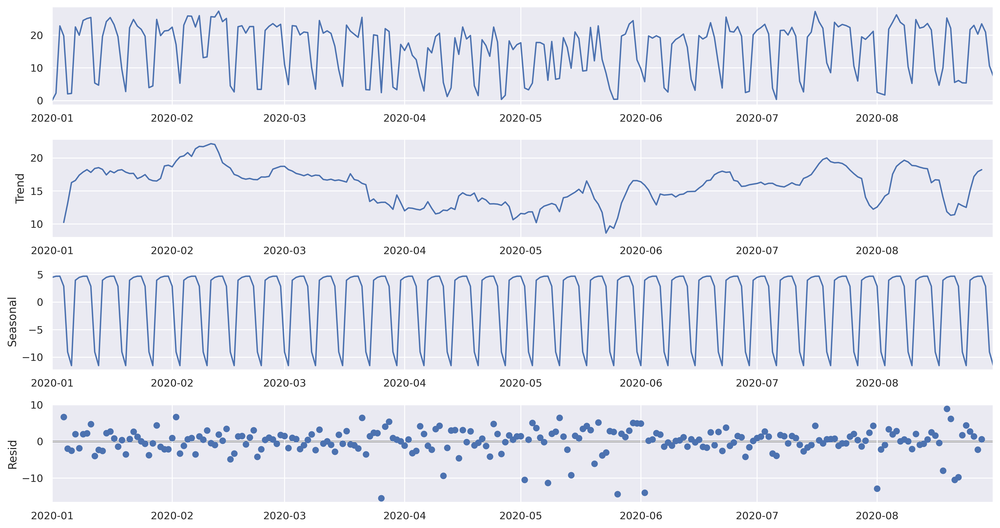

In [18]:
f.seasonal_decompose().plot()#period=5
plt.show()

In [19]:
stat, pval, _, _, _, _ = f.adf_test(full_res=True)
stat

-2.248116091417677

In [20]:
pval

0.18924758203844472

In [21]:
from tensorflow.keras.callbacks import EarlyStopping

# f3.set_validation_length(60)
# automatically tune and forecast with a series of models

f.set_test_length(48)       # 1. 12 observations to test the results
f.generate_future_dates(48) # 2. 12 future points to forecast

# lags = 35
lags = 7

models = (
    # 'mlr',
    # 'knn',
    # 'svr',
    'xgboost',
    # 'gbt',
    # 'elasticnet',
    'mlp',
    # 'prophet',
    'lstm',
    # 'arima',
    )
f.add_ar_terms(lags) # 2. add regressors (24 lagged terms)
# f.add_seasonal_regressors('month','quarter',dummy=True) # 2.
# f.add_seasonal_regressors('year') # 2.
# f.add_time_trend() # 2.
# f.diff() # 3. difference non-stationary data
for m in models:
 print(m)
 f.set_estimator(m)
#  f3.add_ar_terms(4) # 4 AR terms
#  f3.add_AR_terms((2,12)) # 2 seasonal AR terms
#  f3.add_seasonal_regressors('month',raw=False,sincos=True)
#  f3.add_seasonal_regressors('year')
#  f3.add_time_trend() # 2.
#  f3.diff() # 3. difference non-stationary data
 if m == "lstm":
   f.manual_forecast(
                  # call_me='lstm_6lags_earlystop_3layers',
                  lags=lags,
                  epochs=25,
                  validation_split=.2,
                  shuffle=True,
                  callbacks=EarlyStopping(monitor='val_loss',
                                          patience=5),
                  lstm_layer_sizes=(16,16,16),
                  dropout=(0,0,0))
#  elif m == "arima":
#    f.diff()
#    f.fillna_y()
#    f.manual_forecast()
#   #  f.undiff()
 else:
  f.manual_forecast()

xgboost
[01:29:50] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:29:50] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
mlp


lstm
Epoch 1/25
4/4 [==============================] - 8s 480ms/step - loss: 0.5120 - val_loss: 0.6555
Epoch 2/25
4/4 [==============================] - 0s 24ms/step - loss: 0.5011 - val_loss: 0.6416
Epoch 3/25
4/4 [==============================] - 0s 27ms/step - loss: 0.4877 - val_loss: 0.6235
Epoch 4/25
4/4 [==============================] - 0s 24ms/step - loss: 0.4707 - val_loss: 0.6001
Epoch 5/25
4/4 [==============================] - 0s 25ms/step - loss: 0.4496 - val_loss: 0.5706
Epoch 6/25
4/4 [==============================] - 0s 24ms/step - loss: 0.4241 - val_loss: 0.5328
Epoch 7/25
4/4 [==============================] - 0s 26ms/step - loss: 0.3936 - val_loss: 0.4852
Epoch 8/25
4/4 [==============================] - 0s 27ms/step - loss: 0.3596 - val_loss: 0.4296
Epoch 9/25
4/4 [==============================] - 0s 24ms/step - loss: 0.3295 - val_loss: 0.3802
Epoch 10/25
4/4 [==============================] - 0s 34ms/step - loss: 0.3164 - val_loss: 0.3523
Epoch 11/25
4/4 [======

In [23]:
f.set_estimator('arima')
# f.diff()
f.manual_forecast(
    order=(2,0,11),
    # seasonal_order=(2,0,11,14),
    # trend='ct',
    )

<Axes: xlabel='Date', ylabel='Values'>

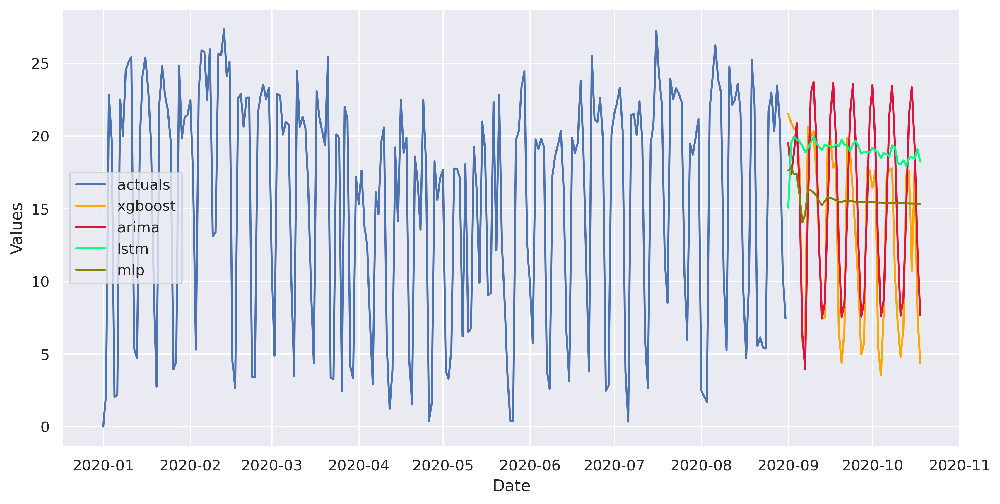

In [24]:
# f.undiff()
f.plot(
    models='top_4',
    order_by='TestSetRMSE', 
    # level=True,
    )

Text(0.5, 1.0, 'Forecast on Actual Dataset')

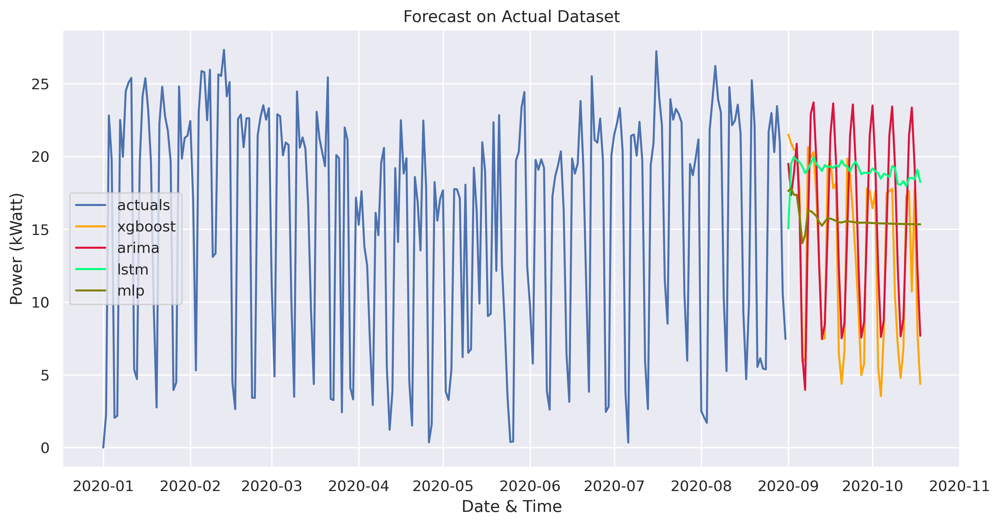

In [63]:
# f.undiff()

# f.ingest_Xvars_df(dataset, date_col='Date', drop_first=True, use_future_dates=False)

f.plot(models='top_4',
       order_by='LevelTestSetR2',
      #  level=True,
       )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast on Actual Dataset")



/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for xgboost. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for arima. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for lstm. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for mlp. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(


Text(0.5, 1.0, 'Forecast Test vs Actual')

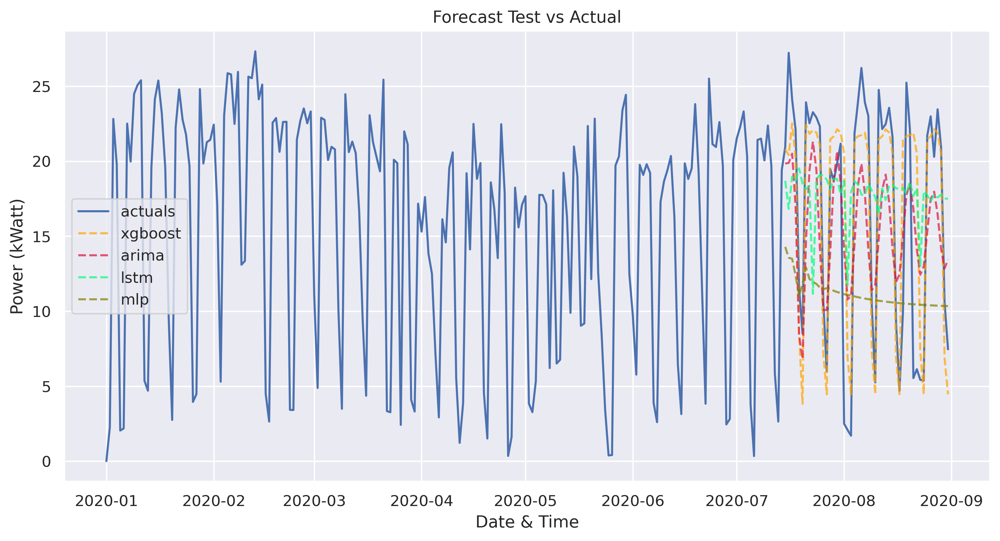

In [26]:
f.plot_test_set(
    order_by='LevelTestSetR2',
    models='top_4', 
    # level=True, 
    ci=True,
    )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast Test vs Actual")

Text(0.5, 1.0, 'Forecast To Whole Actual Data')

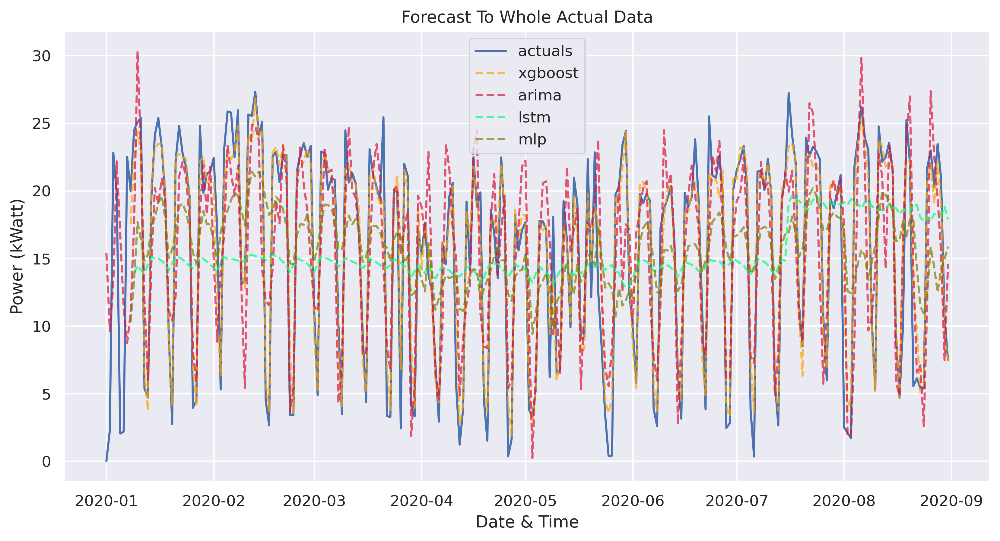

In [27]:
f.plot_fitted(
        order_by='LevelTestSetR2',
        models='top_4', 
        # level=True, 
        # ci=True,
    )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast To Whole Actual Data")

In [28]:
f.export('model_summaries',
         to_excel=True,
         excel_name='arima_results.xlsx',
         determine_best_by='LevelTestSetR2',
         )[
    ['ModelNickname',
     'LevelTestSetMAPE',
     'LevelTestSetRMSE',
     'LevelTestSetR2',
     'best_model']
]

,ModelNickname,LevelTestSetMAPE,LevelTestSetRMSE,LevelTestSetR2,best_model
0,xgboost,0.484059,4.998091,0.610116,True
1,arima,0.691522,6.158400,0.408080,False
2,lstm,1.025430,8.024366,-0.004959,False
3,mlp,0.749998,9.574405,-0.430707,False


In [29]:
ts_preds = f.export('test_set_predictions')

/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5193: FutureWarning: The "test_set_predictions" DataFrame will be removed in a future version of scalecast. To extract test-set predictions for evaluated models, use "lvl_test_set_predictions".
  warnings.warn(


In [30]:
print(ts_preds)
print(ts_preds.shape)

          DATE  actual    xgboost      arima       lstm        mlp
196 2020-07-15   20.94  20.796648  19.852287  18.692660  14.287624
197 2020-07-16   27.23  20.412489  19.885966  16.824019  13.567555
198 2020-07-17   24.11  22.528748  20.503343  18.972580  13.492466
199 2020-07-18   22.11  20.238575  16.939257  18.676751  12.370292
200 2020-07-19   11.52   8.514504   8.375248  19.519521  11.035982
201 2020-07-20    8.51   3.823868   6.830890  18.499160  11.800944
202 2020-07-21   23.93  22.416641  14.683511  18.142359  12.913672
203 2020-07-22   22.53  21.822401  19.383500  18.356483  12.146418
204 2020-07-23   23.27  22.075472  21.311004  11.163113  11.953670
205 2020-07-24   22.92  21.916826  19.416007  18.799913  11.818746
206 2020-07-25   22.33  21.081081  14.215363  19.087108  11.581500
207 2020-07-26   10.58   7.172312  10.088388  19.055321  11.461219
208 2020-07-27    5.97   4.458127  10.069459  18.771669  11.538687
209 2020-07-28   19.48  21.458864  13.977919  18.135694  11.51

<Axes: xlabel='DATE'>

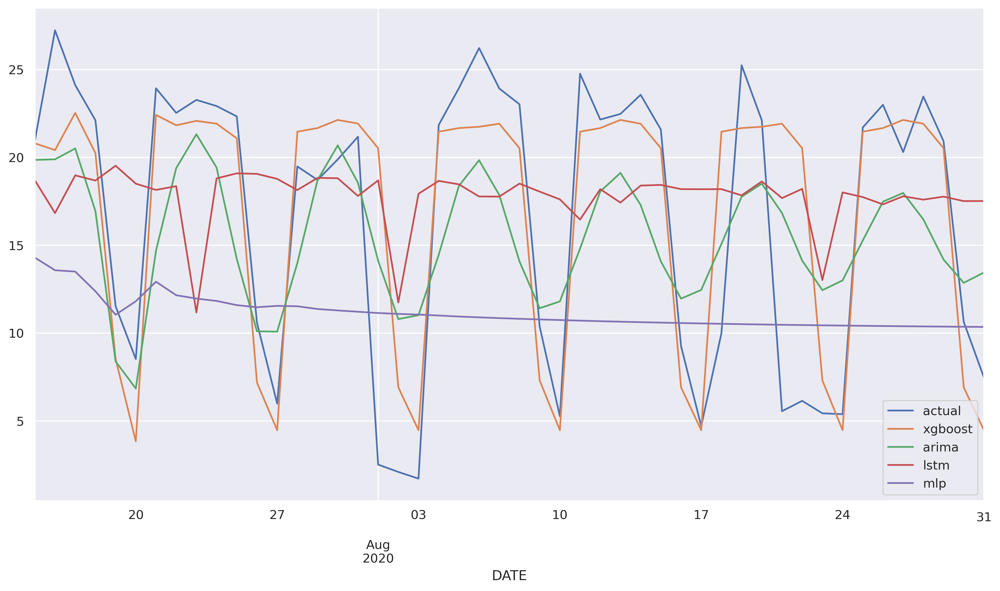

In [31]:
ts_preds.plot(x="DATE")

In [32]:
ts_preds_kwh = ts_preds.iloc[:,1:6].cumsum()

ts_preds_kwh["DATE"] = ts_preds["DATE"]

ts_preds_kwh

,actual,xgboost,arima,lstm,mlp,DATE
196,20.94,20.796648,19.852287,18.692660,14.287624,2020-07-15
197,48.17,41.209137,39.738253,35.516679,27.855179,2020-07-16
198,72.28,63.737885,60.241596,54.489259,41.347644,2020-07-17
199,94.39,83.976456,77.180854,73.166010,53.717936,2020-07-18
200,105.91,92.490959,85.556101,92.685531,64.753918,2020-07-19
201,114.42,96.314827,92.386992,111.184691,76.554862,2020-07-20
202,138.35,118.731468,107.070503,129.327050,89.468535,2020-07-21
203,160.88,140.553864,126.454002,147.683533,101.614953,2020-07-22
204,184.15,162.629333,147.765007,158.846646,113.568622,2020-07-23
205,207.07,184.546158,167.181014,177.646559,125.387368,2020-07-24


Text(0, 0.5, 'Energy (kWh)')

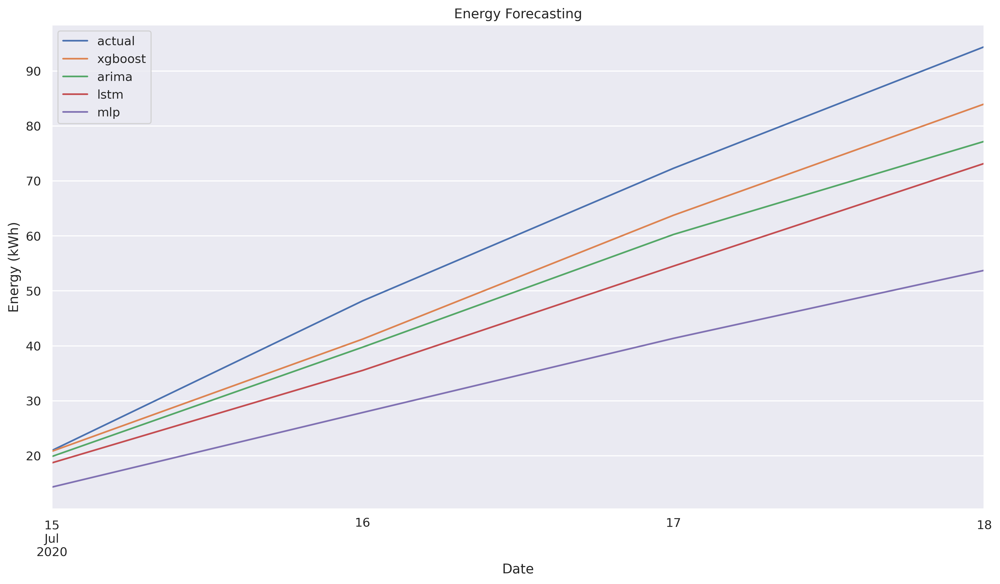

In [33]:
ts_preds_kwh.iloc[0:4,:].plot(x="DATE")

plt.title("Energy Forecasting")
plt.xlabel("Date")
plt.ylabel("Energy (kWh)")

In [34]:
ts_preds_xgboost = ts_preds["xgboost"]
ts_preds_mlp = ts_preds["mlp"]
ts_preds_lstm = ts_preds["lstm"]
ts_preds_arima = ts_preds["arima"]
ts_preds_actual = ts_preds["actual"]

In [35]:
ts_preds_xgboost.shape

(48,)

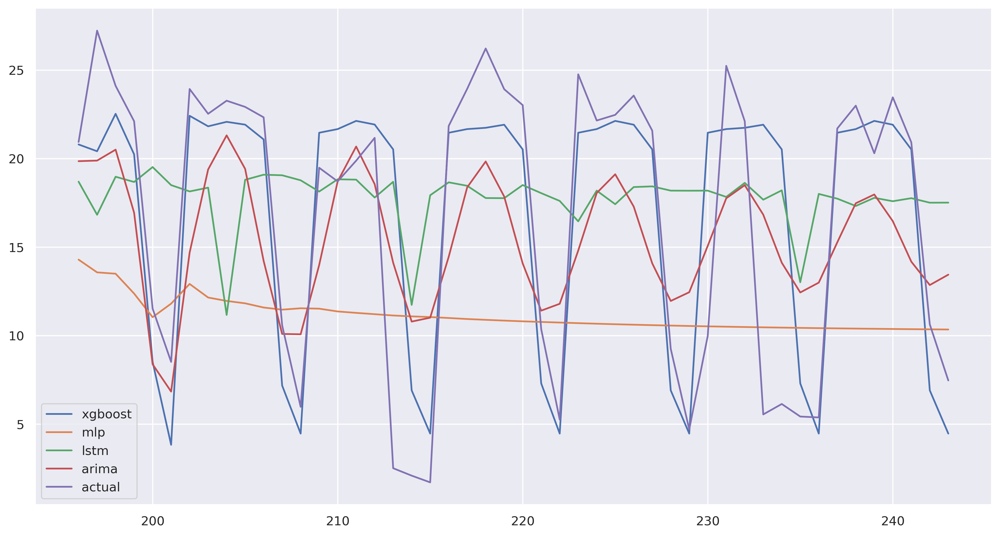

In [36]:
ts_preds_xgboost.plot()
ts_preds_mlp.plot()
ts_preds_lstm.plot()
ts_preds_arima.plot()
ts_preds_actual.plot()
plt.legend()
plt.show()

In [37]:
np_dataset_power = dataset.loc[:,['Power']].iloc[0:-48].values

print(np_dataset_power.shape)

(196, 1)


In [38]:
np_ts_preds_xgboost = ts_preds_xgboost.values
# dataset_power = dataset.loc[:,['Power']].diff()
# np_dataset_power = dataset.loc[:,['Power']].values

np_ts_preds_xgboost = np_ts_preds_xgboost.reshape(-1,1)

print(np_ts_preds_xgboost.shape)
print(np_dataset_power.shape)

np_all_xgboost = np.concatenate((np_dataset_power, np_ts_preds_xgboost), axis = 0)

print(np_all_xgboost)

np_ts_preds_mlp = ts_preds_mlp.values

np_ts_preds_mlp = np_ts_preds_mlp.reshape(-1,1)

print(np_ts_preds_mlp.shape)

np_all_mlp = np.concatenate((np_dataset_power, np_ts_preds_mlp), axis = 0)

print(np_all_mlp)

np_ts_preds_lstm = ts_preds_lstm.values

np_ts_preds_lstm = np_ts_preds_lstm.reshape(-1,1)

print(np_ts_preds_lstm.shape)

np_all_lstm = np.concatenate((np_dataset_power, np_ts_preds_lstm), axis = 0)

print(np_all_lstm)

np_ts_preds_arima = ts_preds_arima.values

np_ts_preds_arima = np_ts_preds_arima.reshape(-1,1)

print(np_ts_preds_arima.shape)

np_all_arima = np.concatenate((np_dataset_power, np_ts_preds_arima), axis = 0)

print(np_all_arima)

np_ts_preds_actual = ts_preds_actual.values

np_ts_preds_actual = np_ts_preds_actual.reshape(-1,1)

print(np_ts_preds_actual.shape)

np_all_actual = np.concatenate((np_dataset_power, np_ts_preds_actual), axis = 0)

print(np_all_actual)

#lstm

(48, 1)
(196, 1)
[[ 0.        ]
 [ 2.26      ]
 [22.82      ]
 [19.77      ]
 [ 2.04      ]
 [ 2.18      ]
 [22.51      ]
 [19.98      ]
 [24.49      ]
 [25.08      ]
 [25.4       ]
 [ 5.36      ]
 [ 4.7       ]
 [19.59      ]
 [24.14      ]
 [25.38      ]
 [23.2       ]
 [19.57      ]
 [ 9.53      ]
 [ 2.75      ]
 [22.25      ]
 [24.79      ]
 [22.78      ]
 [21.78      ]
 [19.67      ]
 [ 3.95      ]
 [ 4.47      ]
 [24.81      ]
 [19.85      ]
 [21.27      ]
 [21.43      ]
 [22.44      ]
 [17.14      ]
 [ 5.3       ]
 [23.06      ]
 [25.87      ]
 [25.79      ]
 [22.49      ]
 [25.96      ]
 [13.1       ]
 [13.35      ]
 [25.64      ]
 [25.54      ]
 [27.33      ]
 [24.13      ]
 [25.11      ]
 [ 4.5       ]
 [ 2.64      ]
 [22.57      ]
 [22.88      ]
 [20.63      ]
 [22.62      ]
 [22.63      ]
 [ 3.42      ]
 [ 3.41      ]
 [21.44      ]
 [22.7       ]
 [23.52      ]
 [22.53      ]
 [23.32      ]
 [11.13      ]
 [ 4.88      ]
 [22.9       ]
 [22.76      ]
 [20.08      ]
 [20.96 

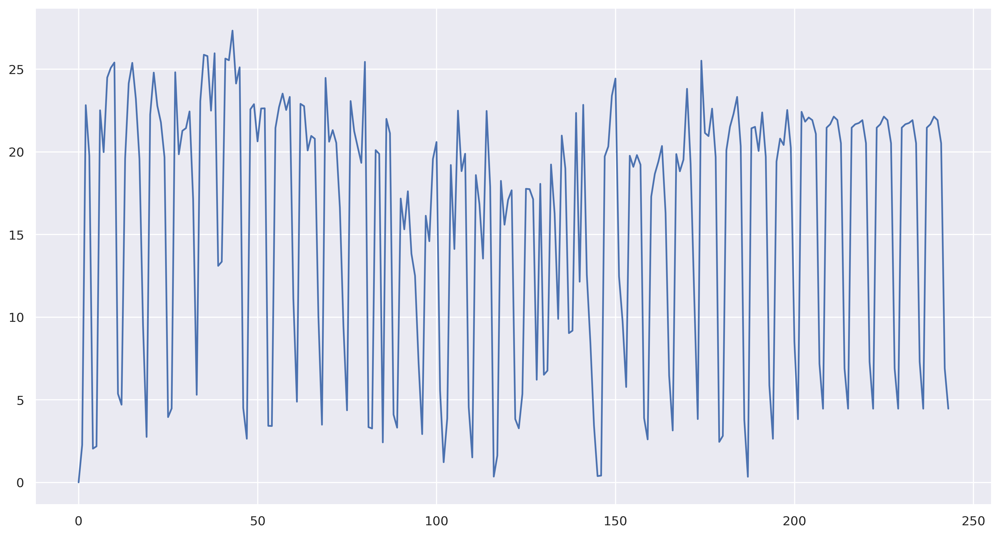

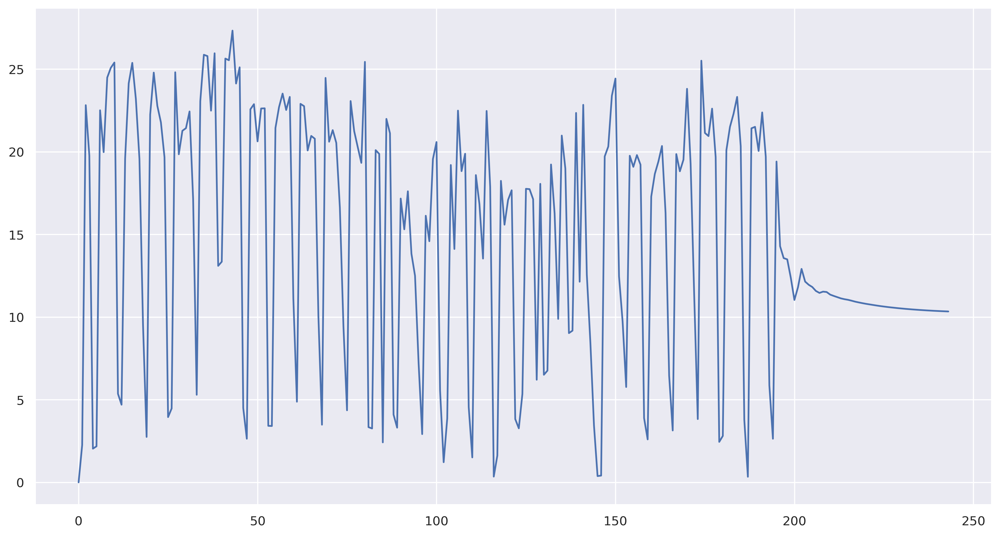

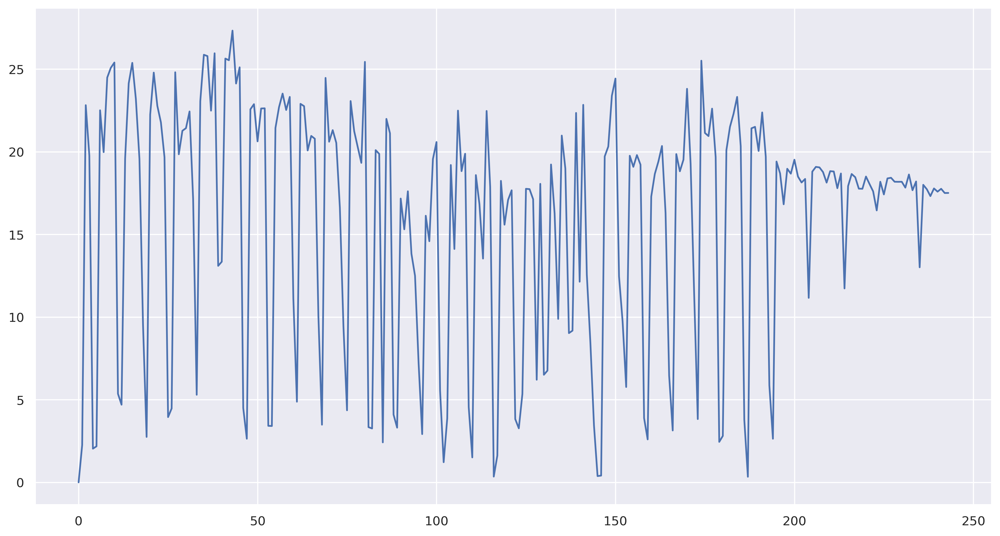

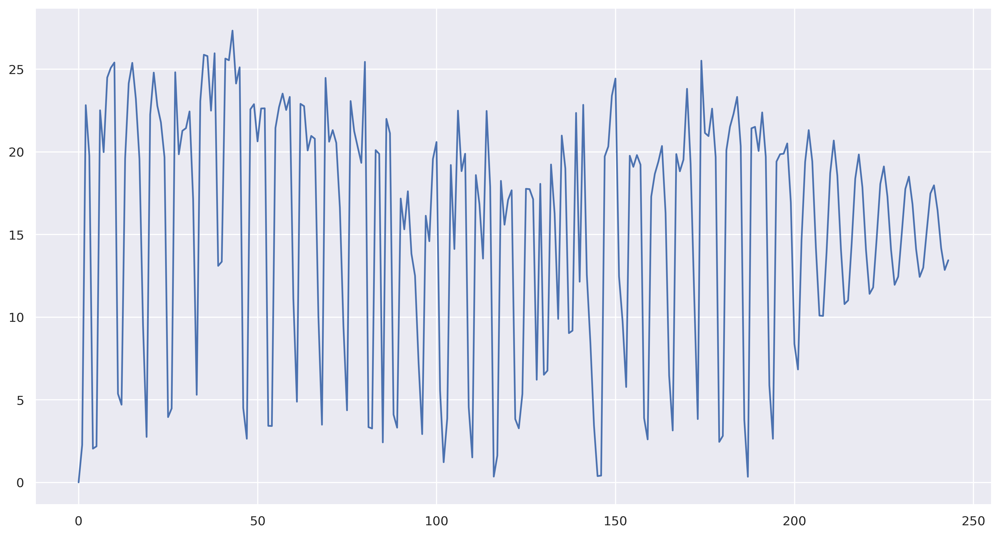

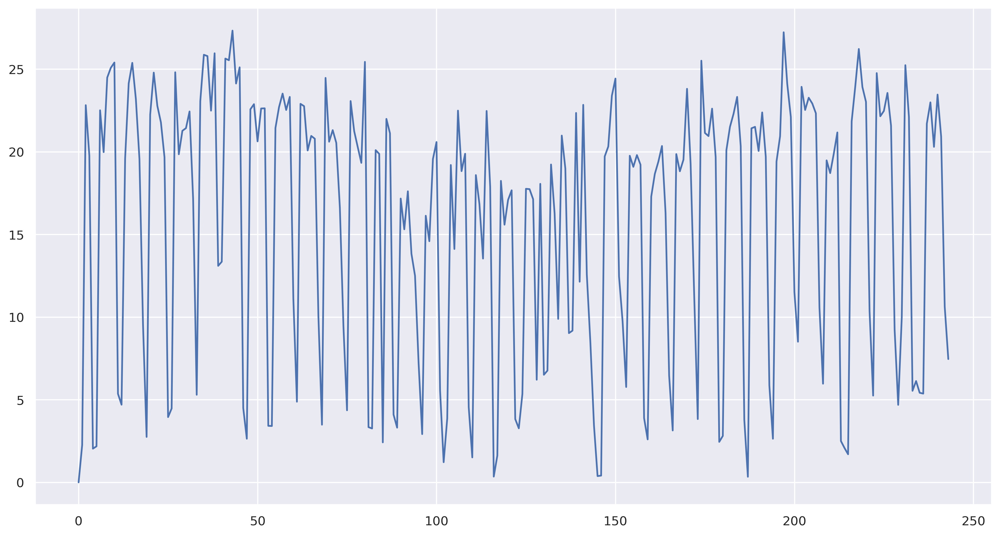

In [39]:
plt.plot(np_all_xgboost)
plt.show()
plt.plot(np_all_mlp)
plt.show()
plt.plot(np_all_lstm)
plt.show()
plt.show()
plt.plot(np_all_arima)
plt.show()
plt.plot(np_all_actual)
plt.show()

In [40]:
np_all_xgboost_res = np_all_xgboost.reshape(-1)

np_all_xgboost_res = np.delete(np_all_xgboost_res, 0)

print(np_all_xgboost_res)

#all

np_all_mlp_res = np_all_mlp.reshape(-1)

np_all_mlp_res = np_all_mlp_res[~np.isnan(np_all_mlp_res)]

# np_all_res = np.delete(np_all_res, 0)

print(np_all_mlp_res)

#all_mlp

np_all_lstm_res = np_all_lstm.reshape(-1)

np_all_lstm_res = np_all_lstm_res[~np.isnan(np_all_lstm_res)]

# np_all_res = np.delete(np_all_res, 0)

print(np_all_lstm_res)

#all_mlp

np_all_arima_res = np_all_arima.reshape(-1)

np_all_arima_res = np_all_arima_res[~np.isnan(np_all_arima_res)]

# np_all_res = np.delete(np_all_res, 0)

print(np_all_arima_res)

#all_mlp

np_all_actual_res = np_all_actual.reshape(-1)

np_all_actual_res = np_all_actual_res[~np.isnan(np_all_actual_res)]

# np_all_res = np.delete(np_all_res, 0)

print(np_all_actual_res)

#all_mlp

[ 2.26       22.82       19.77        2.04        2.18       22.51
 19.98       24.49       25.08       25.4         5.36        4.7
 19.59       24.14       25.38       23.2        19.57        9.53
  2.75       22.25       24.79       22.78       21.78       19.67
  3.95        4.47       24.81       19.85       21.27       21.43
 22.44       17.14        5.3        23.06       25.87       25.79
 22.49       25.96       13.1        13.35       25.64       25.54
 27.33       24.13       25.11        4.5         2.64       22.57
 22.88       20.63       22.62       22.63        3.42        3.41
 21.44       22.7        23.52       22.53       23.32       11.13
  4.88       22.9        22.76       20.08       20.96       20.79
 10.08        3.49       24.47       20.61       21.31       20.54
 16.62        9.43        4.36       23.07       21.25       20.28
 19.33       25.44        3.34        3.26       20.1        19.87
  2.42       21.99       21.12        4.1         3.31       17

In [41]:
dataset.columns

Index(['Date', 'Energy', 'Power'], dtype='object')

In [42]:
np_date = dataset.loc[:,"Date"].values

In [61]:
first = -60+8
# last = -60+8+4+10
last = -1

np_cumsum_xgboost = np.cumsum(np_all_xgboost_res[first:last])

print(np_cumsum_xgboost)

np_cumsum_mlp = np.cumsum(np_all_mlp_res[first:last])

print(np_cumsum_mlp)

np_cumsum_lstm = np.cumsum(np_all_lstm_res[first:last])

print(np_cumsum_lstm)

np_cumsum_arima = np.cumsum(np_all_arima_res[first:last])

print(np_cumsum_arima)

np_cumsum_actual = np.cumsum(np_all_actual_res[first:last])

print(np_cumsum_actual)

cumsum_date = np_date[first:last]

print(cumsum_date)

print(np_cumsum_actual.shape)
print(cumsum_date.shape)

[ 19.7         25.57        28.21        47.62        68.41664803
  88.82913696 111.35788452 131.5964595  140.11096394 143.93483221
 166.35147345 188.17387449 210.24934637 232.16617262 253.24725401
 260.41956579 264.87769281 286.33655703 308.00207483 330.13047182
 352.05343401 372.57159578 379.47162878 383.9297558  405.38862001
 427.05413782 448.79281771 470.70604288 491.22420465 498.51683008
 502.9749571  524.43382132 546.09933912 568.22773611 590.14096128
 610.65912306 617.55915606 622.01728308 643.47614729 665.1416651
 686.88034498 708.79357016 729.31173193 736.60435736 741.06248438
 762.52134859 784.1868664  806.31526339 828.22848856 848.74665033
 855.64668333]
[ 19.7         25.57        28.21        47.62        61.9076236
  75.47517862  88.96764445 101.33793647 112.37391801 124.17486246
 137.08853457 149.23495262 161.18862218 173.00736835 184.58886816
 196.05008694 207.58877384 219.1056048  230.46497967 241.7438362
 252.94887424 264.07983466 275.1610965  286.20460963 297.1941943

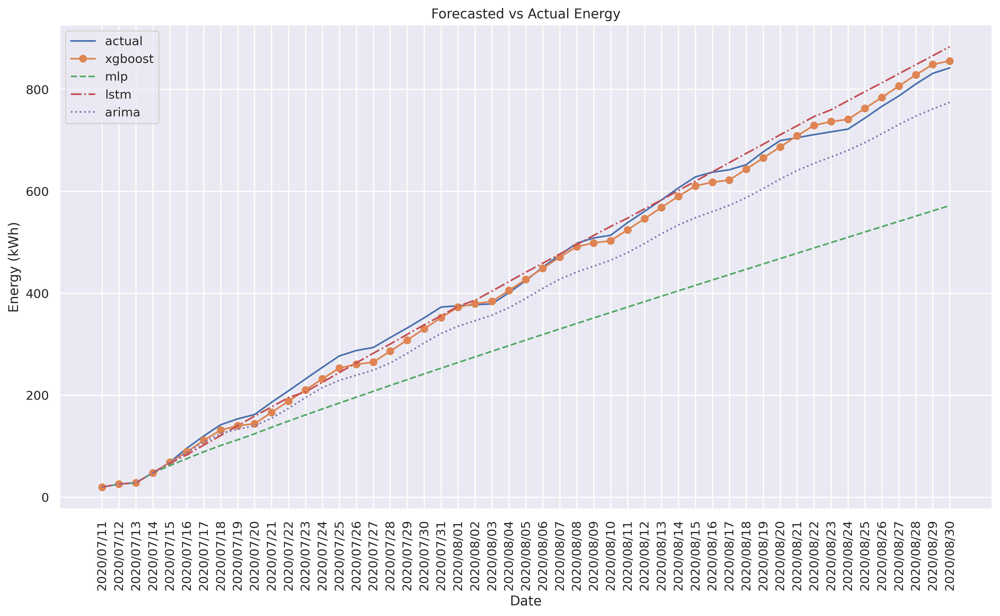

In [62]:
plt.plot(cumsum_date, np_cumsum_actual, label="actual")
plt.plot(cumsum_date, np_cumsum_xgboost, label="xgboost", marker="o")
plt.plot(cumsum_date, np_cumsum_mlp, label="mlp", linestyle="--")
plt.plot(cumsum_date, np_cumsum_lstm, label="lstm", linestyle="-.")
plt.plot(cumsum_date, np_cumsum_arima, label="arima", linestyle=":")
plt.legend()
plt.xticks(rotation=90)
plt.xlabel("Date")
plt.ylabel("Energy (kWh)")
plt.title("Forecasted vs Actual Energy")
plt.show()

In [45]:
import pandas as pd

dataset1 = pd.read_csv('/content/drive/MyDrive/0. Paper/0. Kinetik/2023/biofarma_electricity_no_covid.csv')

dataset2 = pd.read_csv('/content/drive/MyDrive/0. Paper/0. Kinetik/2023/biofarma_electricity_covid.csv')

In [46]:
dataset1.columns

Index(['Date', 'Energy', 'Power'], dtype='object')

In [47]:
rvs1 = dataset1["Power"].values
rvs2 = dataset2["Power"].values


In [48]:
import numpy as np
from scipy import stats

stats.ttest_ind(rvs1, rvs2)

Ttest_indResult(statistic=2.7032926510009125, pvalue=0.007352366977892912)

In [49]:
f2 = Forecaster(y=df['Power'],
                   current_dates=df['Date'])
f2

Forecaster(
    DateStartActuals=2020-01-01T00:00:00.000000000
    DateEndActuals=2020-08-31T00:00:00.000000000
    Freq=D
    N_actuals=244
    ForecastLength=0
    Xvars=[]
    Differenced=0
    TestLength=0
    ValidationLength=1
    ValidationMetric=rmse
    ForecastsEvaluated=[]
    CILevel=None
    CurrentEstimator=None
    GridsFile=Grids
)

In [50]:
from tensorflow.keras.callbacks import EarlyStopping

# f3.set_validation_length(60)
# automatically tune and forecast with a series of models

f2.set_test_length(48)       # 1. 12 observations to test the results
f2.generate_future_dates(48) # 2. 12 future points to forecast

# lagses = range(3, 7+1, 1)
lagses = range(1,10+1)

# lags = 35

f2.set_estimator('xgboost')


for i in lagses:
  f2.add_ar_terms(i) # 2. add regressors (24 lagged terms)
  f2.add_seasonal_regressors('month','quarter',dummy=True) # 2.
  f2.add_seasonal_regressors('year') # 2.
  f2.add_time_trend() # 2.
  # f.diff() # 3. difference non-stationary data
  f2.manual_forecast(
                  call_me='%02d'%i,
                  )
  



[01:46:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:46:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

Text(0.5, 1.0, 'Forecast on Actual Dataset')

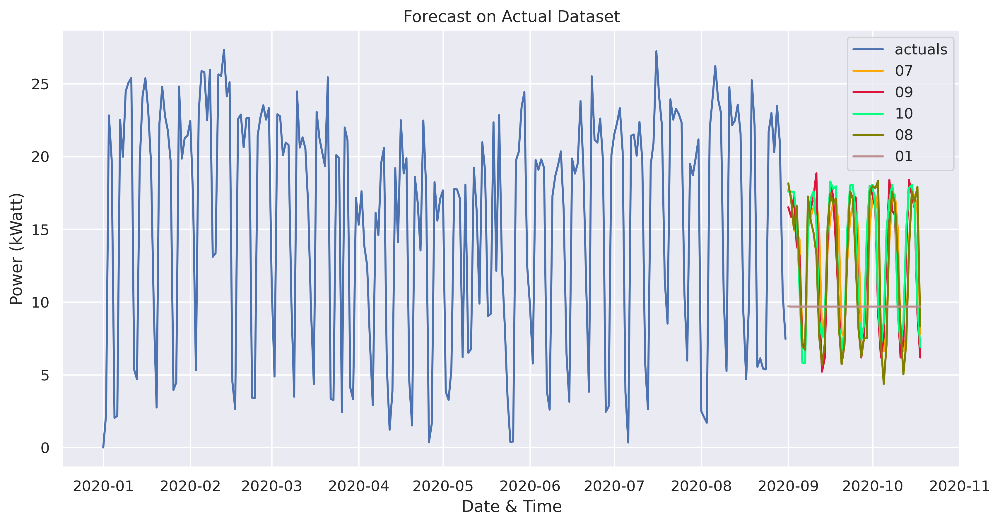

In [51]:
# f.undiff()

# f.ingest_Xvars_df(dataset, date_col='Date', drop_first=True, use_future_dates=False)

f2.plot(models='top_5',
       order_by='LevelTestSetMAPE',
      #  level=True,
       )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast on Actual Dataset")



/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for 07. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for 09. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for 10. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for 08. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found

Text(0.5, 1.0, 'Forecast Test vs Actual')

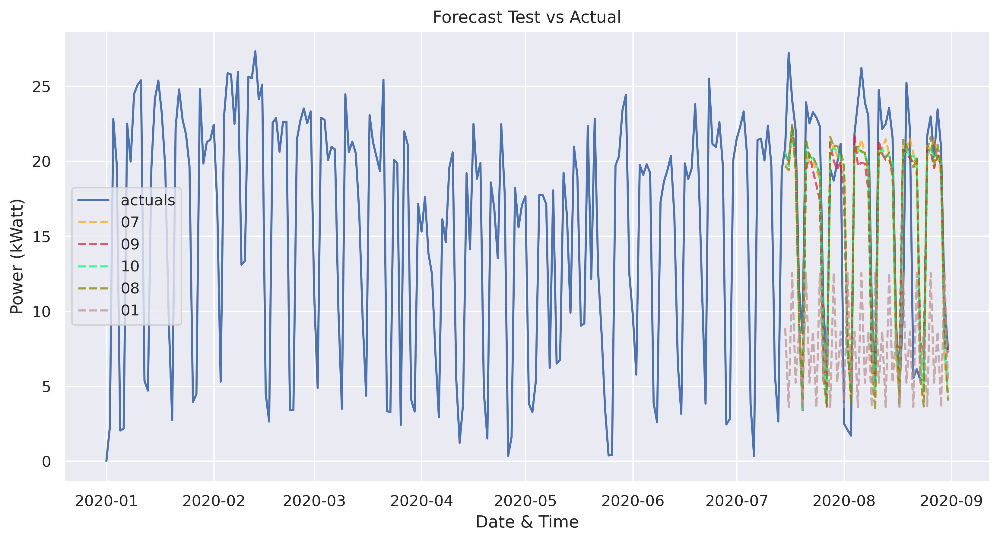

In [52]:
f2.plot_test_set(
    order_by='LevelTestSetMAPE',
    models='top_5', 
    # level=True, 
    ci=True,
    )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast Test vs Actual")

Text(0.5, 1.0, 'Forecast To Whole Actual Data')

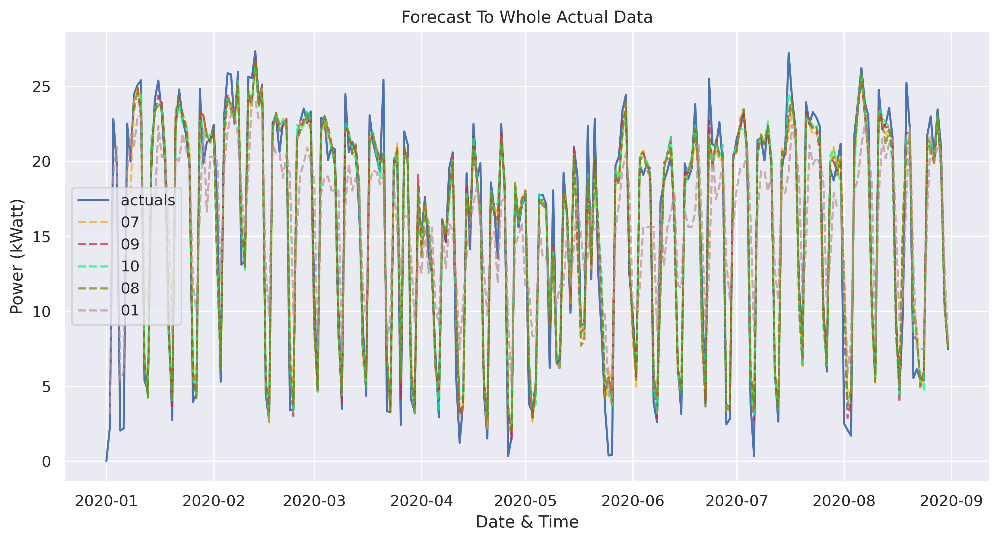

In [53]:
f2.plot_fitted(
        order_by='LevelTestSetMAPE',
        models='top_5', 
        # level=True, 
        # ci=True,
    )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast To Whole Actual Data")

In [54]:
f2_export = f2.export('model_summaries',
        #  to_excel=True,
        #  excel_name='arima_results.xlsx',
         determine_best_by='LevelTestSetMAPE',
         )[
    ['ModelNickname',
     'LevelTestSetMAPE',
     'LevelTestSetRMSE',
     'LevelTestSetR2',
     'best_model']
]

In [55]:
print(f2_export.columns)

Index(['ModelNickname', 'LevelTestSetMAPE', 'LevelTestSetRMSE',
       'LevelTestSetR2', 'best_model'],
      dtype='object')


In [56]:
print(f2_export.sort_values(by=['ModelNickname'], ascending=True))

  ModelNickname  LevelTestSetMAPE  LevelTestSetRMSE  LevelTestSetR2  \
4            01          0.718830         12.636137       -1.492044   
9            02          1.137365          8.877810       -0.230095   
7            03          0.992761          8.373515       -0.094316   
6            04          0.904415          8.575465       -0.147737   
5            05          0.721131          6.607225        0.318658   
8            06          1.060858          9.736543       -0.479574   
0            07          0.482782          4.927481        0.621054   
3            08          0.500355          5.063083        0.599911   
1            09          0.487816          4.977329        0.613348   
2            10          0.489830          4.976345        0.613501   

   best_model  
4       False  
9       False  
7       False  
6       False  
5       False  
8       False  
0        True  
3       False  
1       False  
2       False  


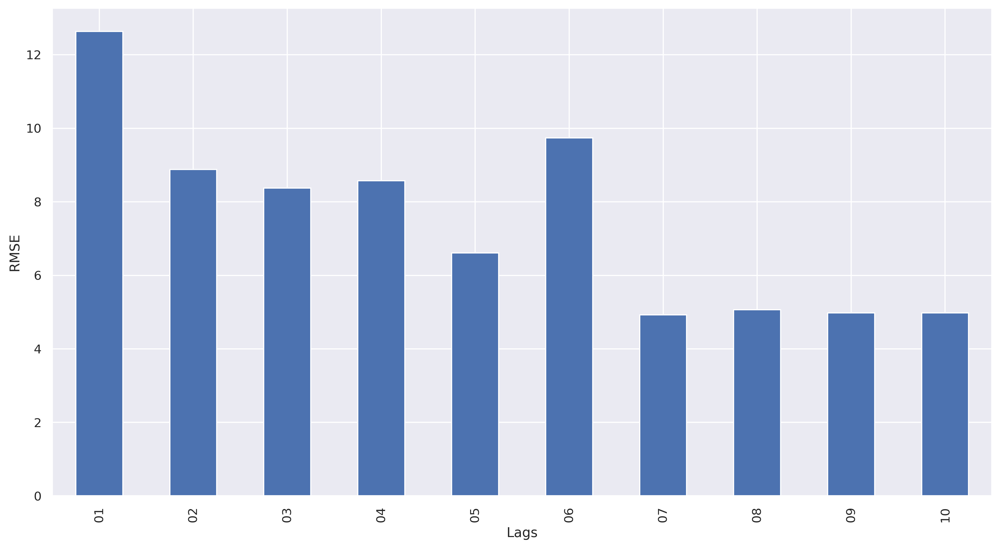

In [57]:
plt.rcParams["figure.dpi"] = 330

f2_export.sort_values(by=['ModelNickname'], ascending=True).plot.bar(x = 'ModelNickname', y = 'LevelTestSetRMSE', legend=None)

# plt.invert_xaxis()

# plt.xticks(range(len(exported_epoch['ModelNickname'])), lepoch, rotation=0)

plt.ylabel("RMSE")

plt.xlabel("Lags")

# plt.xlim(-0.5,4.5)

plt.show()

In [64]:
from tensorflow.keras.callbacks import EarlyStopping

# f3.set_validation_length(60)
# automatically tune and forecast with a series of models

f4 = Forecaster(y=df['Power'],
                   current_dates=df['Date'])
f4

f4.set_test_length(48)       # 1. 12 observations to test the results
f4.generate_future_dates(48) # 2. 12 future points to forecast

# lags = 35
lags = 7

models = (
    # 'mlr',
    # 'knn',
    # 'svr',
    'xgboost',
    # 'gbt',
    # 'elasticnet',
    'mlp',
    # 'prophet',
    'lstm',
    # 'arima',
    )
f4.add_ar_terms(lags) # 2. add regressors (24 lagged terms)
f4.add_seasonal_regressors('month','quarter',dummy=True) # 2.
f4.add_seasonal_regressors('year') # 2.
f4.add_time_trend() # 2.
# f.diff() # 3. difference non-stationary data
for m in models:
 print(m)
 f4.set_estimator(m)
#  f3.add_ar_terms(4) # 4 AR terms
#  f3.add_AR_terms((2,12)) # 2 seasonal AR terms
#  f3.add_seasonal_regressors('month',raw=False,sincos=True)
#  f3.add_seasonal_regressors('year')
#  f3.add_time_trend() # 2.
#  f3.diff() # 3. difference non-stationary data
 if m == "lstm":
   f4.manual_forecast(
                  # call_me='lstm_6lags_earlystop_3layers',
                  lags=lags,
                  epochs=25,
                  validation_split=.2,
                  shuffle=True,
                  callbacks=EarlyStopping(monitor='val_loss',
                                          patience=5),
                  lstm_layer_sizes=(16,16,16),
                  dropout=(0,0,0))
#  elif m == "arima":
#    f.diff()
#    f.fillna_y()
#    f.manual_forecast()
#   #  f.undiff()
 else:
  f4.manual_forecast()

xgboost
[04:56:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:56:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
mlp


lstm
Epoch 1/25
4/4 [==============================] - 16s 660ms/step - loss: 0.5226 - val_loss: 0.6690
Epoch 2/25
4/4 [==============================] - 0s 26ms/step - loss: 0.5138 - val_loss: 0.6603
Epoch 3/25
4/4 [==============================] - 0s 26ms/step - loss: 0.5056 - val_loss: 0.6512
Epoch 4/25
4/4 [==============================] - 0s 32ms/step - loss: 0.4968 - val_loss: 0.6401
Epoch 5/25
4/4 [==============================] - 0s 27ms/step - loss: 0.4861 - val_loss: 0.6259
Epoch 6/25
4/4 [==============================] - 0s 29ms/step - loss: 0.4723 - val_loss: 0.6071
Epoch 7/25
4/4 [==============================] - 0s 28ms/step - loss: 0.4545 - val_loss: 0.5818
Epoch 8/25
4/4 [==============================] - 0s 24ms/step - loss: 0.4317 - val_loss: 0.5493
Epoch 9/25
4/4 [==============================] - 0s 29ms/step - loss: 0.4035 - val_loss: 0.5072
Epoch 10/25
4/4 [==============================] - 0s 24ms/step - loss: 0.3700 - val_loss: 0.4559
Epoch 11/25
4/4 [=====

In [65]:
f4.set_estimator('arima')
# f.diff()
f4.manual_forecast(
    order=(2,0,11),
    # seasonal_order=(2,0,11,14),
    # trend='ct',
    )

<Axes: xlabel='Date', ylabel='Values'>

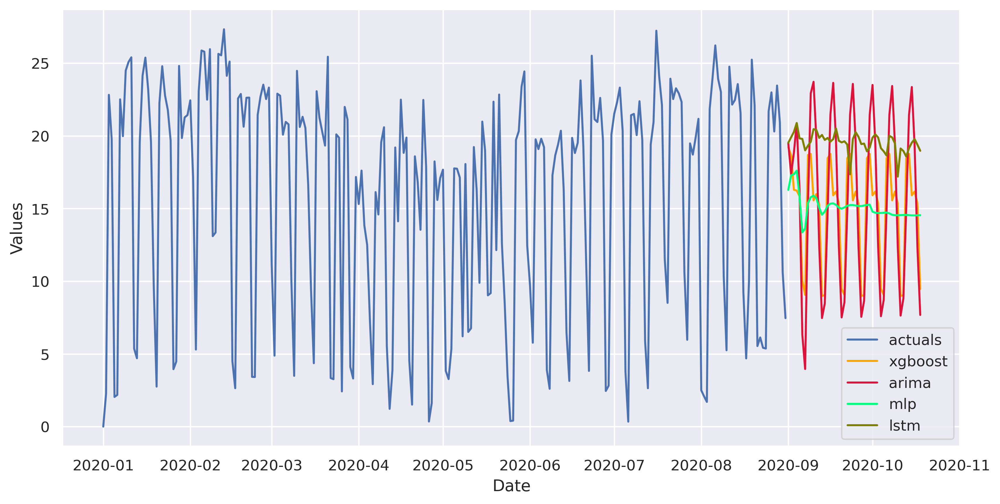

In [66]:
# f.undiff()
f4.plot(
    models='top_4',
    order_by='TestSetRMSE', 
    # level=True,
    )

Text(0.5, 1.0, 'Forecast on Actual Dataset')

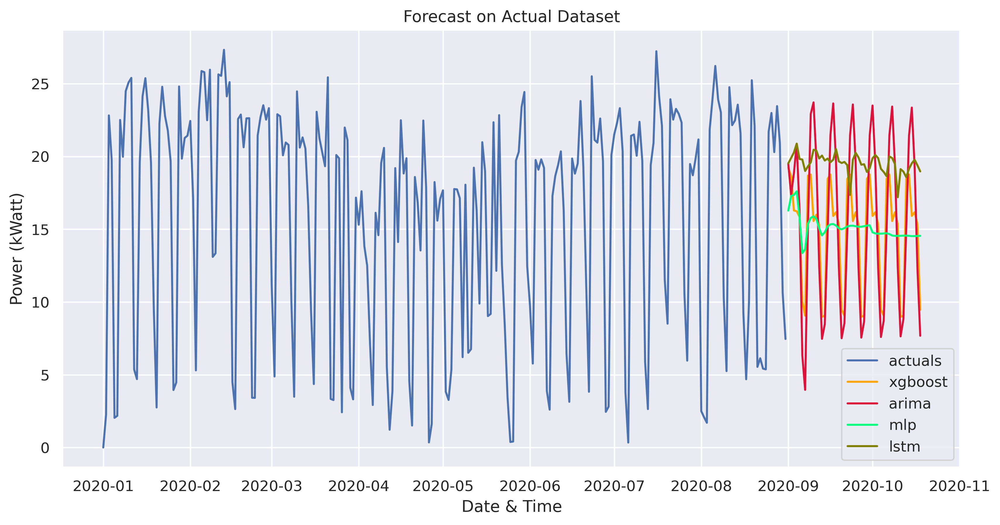

In [67]:
# f.undiff()

# f.ingest_Xvars_df(dataset, date_col='Date', drop_first=True, use_future_dates=False)

f4.plot(models='top_4',
       order_by='LevelTestSetR2',
      #  level=True,
       )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast on Actual Dataset")



/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for xgboost. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for arima. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for mlp. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/scalecast/Forecaster.py:5650: Warning: Confidence intervals not found for lstm. To turn on confidence intervals for future evaluated models, call the eval_cis() method.
  warnings.warn(


Text(0.5, 1.0, 'Forecast Test vs Actual')

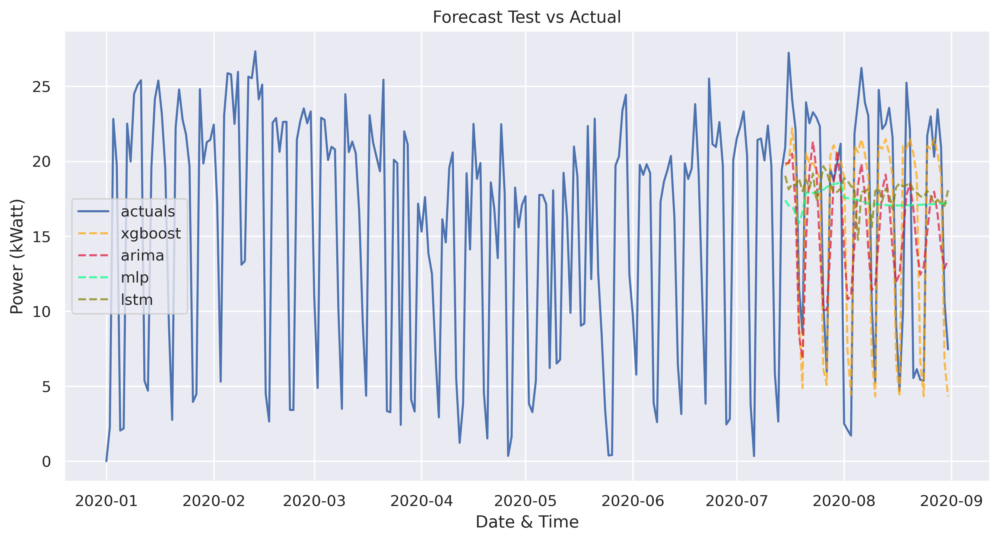

In [68]:
f4.plot_test_set(
    order_by='LevelTestSetR2',
    models='top_4', 
    # level=True, 
    ci=True,
    )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast Test vs Actual")

Text(0.5, 1.0, 'Forecast To Whole Actual Data')

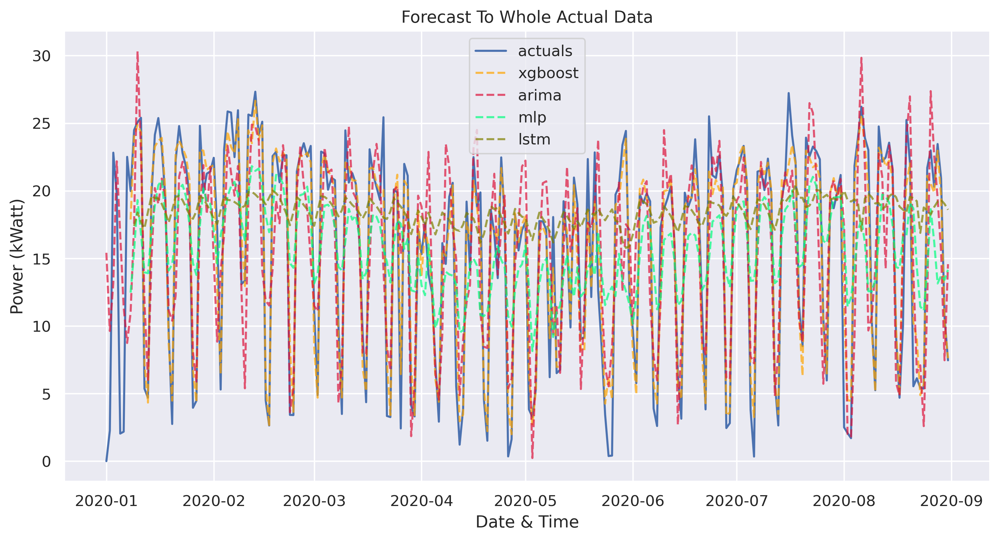

In [69]:
f4.plot_fitted(
        order_by='LevelTestSetR2',
        models='top_4', 
        # level=True, 
        # ci=True,
    )

plt.xlabel("Date & Time")
plt.ylabel("Power (kWatt)")
plt.title("Forecast To Whole Actual Data")

In [70]:
f4.export('model_summaries',
         to_excel=True,
         excel_name='sarima_results.xlsx',
         determine_best_by='LevelTestSetR2',
         )[
    ['ModelNickname',
     'LevelTestSetMAPE',
     'LevelTestSetRMSE',
     'LevelTestSetR2',
     'best_model']
]

,ModelNickname,LevelTestSetMAPE,LevelTestSetRMSE,LevelTestSetR2,best_model
0,xgboost,0.482782,4.927481,0.621054,True
1,arima,0.691522,6.158400,0.408080,False
2,mlp,1.057842,7.996452,0.002020,False
3,lstm,1.117925,8.276994,-0.069233,False
